# Intro
This notebook is used to generate a labeled logging scars dataset. The data is hand labeled by our team using geojson.io.

## Installing packages

In [1]:
!pip install -q osmnx geopandas rasterio
!pip install -q geemap

     ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 98.8/98.8 kB 2.8 MB/s eta 0:00:00
     ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 21.3/21.3 MB 42.5 MB/s eta 0:00:00
     ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 2.2/2.2 MB 23.2 MB/s eta 0:00:00
     ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 1.2/1.2 MB 56.7 MB/s eta 0:00:00
     ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 98.6/98.6 kB 9.4 MB/s eta 0:00:00
     ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 130.5/130.5 kB 13.7 MB/s eta 0:00:00
     ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 3.4/3.4 MB 70.1 MB/s eta 0:00:00
     ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 1.3/1.3 MB 64.3 MB/s eta 0:00:00
  Preparing metadata (setup.py) ... done
     ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 46.5/46.5 kB 4.0 MB/s eta 0:00:00
     ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 3.2/3.2 MB 74.7 MB/s eta 0:00:00
     ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 56.7/56.7 kB 4.6 MB/s eta 0:00:00
     ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 1.6/1.6 MB 60.8 MB/s eta 0:00:00


## Importing Libraries

In [2]:
import geemap.foliumap as geemap
import osmnx as ox
import matplotlib.pyplot as plt
import geopandas as gpd
from shapely.geometry import Point, LineString, Polygon
import osmnx as ox
import rasterio
from rasterio.features import rasterize
import numpy as np
from pyproj import CRS
from shapely.ops import transform
from functools import partial
import pyproj
import ee
from rasterio.windows import Window
import time
import pandas as pd
import os
from os.path import isfile, join
from rasterio.features import geometry_mask
import os
import pyarrow as pa
import pyarrow.parquet as pq
from osgeo import gdal, osr
import random
from google.colab import drive

## Setup Drive


In [3]:
drive.mount('/content/drive')


Drive already mounted at /content/drive; to attempt to forcibly remount, call drive.mount("/content/drive", force_remount=True).


# Utlitities to access data


In [3]:


# define some constants for easy access to data sets on disk.
# the directory structures for these datasets have been made consistent,
# with the same names for training, test, validation, images and masks across all.

forests = ['amazon', 'atlantic']
data_sets = ['train', 'test', 'val']

def get_paths_to_data( forest, dataset ):

    base_path = '/content/drive/MyDrive/content/drive/GreenGuardians/'
    atlantic_path = 'ATLANTIC512/'
    amazon_path = 'AMAZON512/'

    train_path = 'Training/'
    test_path = 'Test/'
    val_path = 'Validation/'

    images_path = 'images/'
    masks_path = 'masks/'

    dataset_path = base_path

    if forest == 'amazon':
        dataset_path = dataset_path + amazon_path
    elif forest =='atlantic':
        dataset_path = dataset_path + atlantic_path
    else:
        "unknown forest requested"
        return

    if dataset == 'train':
        dataset_path = dataset_path + train_path
    elif dataset == 'test':
        dataset_path = dataset_path + test_path
    elif dataset == 'val':
        dataset_path = dataset_path + val_path
    else:
        "unknown dataset"
        return


    return dataset_path + images_path, dataset_path + masks_path


def get_path_to_output( forest, dataset ):
    base_path = '/content/drive/MyDrive/content/drive/GreenGuardians/'
    atlantic_path = 'ATLANTIC256/'
    amazon_path = 'AMAZON256/'

    train_path = 'Training/'
    test_path = 'Test/'
    val_path = 'Validation/'

    images_path = 'images/'
    masks_path = 'masks/'

    dataset_path = base_path

    if forest == 'amazon':
        dataset_path = dataset_path + amazon_path
    elif forest =='atlantic':
        dataset_path = dataset_path + atlantic_path
    else:
        "unknown forest requested"
        return

    if dataset == 'train':
        dataset_path = dataset_path + train_path
    elif dataset == 'test':
        dataset_path = dataset_path + test_path
    elif dataset == 'val':
        dataset_path = dataset_path + val_path
    else:
        "unknown dataset"
        return


    return dataset_path + images_path, dataset_path + masks_path




In [4]:
# setup directory paths for images and masks for all the possible data sets
amazon_train = get_paths_to_data('amazon', 'train')
print( amazon_train)

amazon_test = get_paths_to_data('amazon', 'test')
print( amazon_test)

amazon_val = get_paths_to_data('amazon', 'val')
print( amazon_val)

atlantic_train = get_paths_to_data('atlantic', 'train')
print( atlantic_train)

atlantic_test = get_paths_to_data('atlantic', 'test')
print( atlantic_test)

atlantic_val = get_paths_to_data('atlantic', 'val')
print( atlantic_val)

('/content/drive/MyDrive/content/drive/GreenGuardians/AMAZON512/Training/images/', '/content/drive/MyDrive/content/drive/GreenGuardians/AMAZON512/Training/masks/')
('/content/drive/MyDrive/content/drive/GreenGuardians/AMAZON512/Test/images/', '/content/drive/MyDrive/content/drive/GreenGuardians/AMAZON512/Test/masks/')
('/content/drive/MyDrive/content/drive/GreenGuardians/AMAZON512/Validation/images/', '/content/drive/MyDrive/content/drive/GreenGuardians/AMAZON512/Validation/masks/')
('/content/drive/MyDrive/content/drive/GreenGuardians/ATLANTIC512/Training/images/', '/content/drive/MyDrive/content/drive/GreenGuardians/ATLANTIC512/Training/masks/')
('/content/drive/MyDrive/content/drive/GreenGuardians/ATLANTIC512/Test/images/', '/content/drive/MyDrive/content/drive/GreenGuardians/ATLANTIC512/Test/masks/')
('/content/drive/MyDrive/content/drive/GreenGuardians/ATLANTIC512/Validation/images/', '/content/drive/MyDrive/content/drive/GreenGuardians/ATLANTIC512/Validation/masks/')


In [89]:
# setup directory paths for images and masks for all the possible output data sets
amazon_train_256 = get_path_to_output('amazon', 'train')
print( amazon_train_256)

amazon_test_256 = get_path_to_output('amazon', 'test')
print( amazon_test_256)

amazon_val_256 = get_path_to_output('amazon', 'val')
print( amazon_val_256)

atlantic_train_256 = get_path_to_output('atlantic', 'train')
print( atlantic_train_256)

atlantic_test_256 = get_path_to_output('atlantic', 'test')
print( atlantic_test_256)

atlantic_val_256 = get_path_to_output('atlantic', 'val')
print( atlantic_val_256)

('/content/drive/MyDrive/content/drive/GreenGuardians/AMAZON256/Training/images/', '/content/drive/MyDrive/content/drive/GreenGuardians/AMAZON256/Training/masks/')
('/content/drive/MyDrive/content/drive/GreenGuardians/AMAZON256/Test/images/', '/content/drive/MyDrive/content/drive/GreenGuardians/AMAZON256/Test/masks/')
('/content/drive/MyDrive/content/drive/GreenGuardians/AMAZON256/Validation/images/', '/content/drive/MyDrive/content/drive/GreenGuardians/AMAZON256/Validation/masks/')
('/content/drive/MyDrive/content/drive/GreenGuardians/ATLANTIC256/Training/images/', '/content/drive/MyDrive/content/drive/GreenGuardians/ATLANTIC256/Training/masks/')
('/content/drive/MyDrive/content/drive/GreenGuardians/ATLANTIC256/Test/images/', '/content/drive/MyDrive/content/drive/GreenGuardians/ATLANTIC256/Test/masks/')
('/content/drive/MyDrive/content/drive/GreenGuardians/ATLANTIC256/Validation/images/', '/content/drive/MyDrive/content/drive/GreenGuardians/ATLANTIC256/Validation/masks/')


# Create 4 256x256 images from 1 512x512 for every file in the dataset.

In [112]:
def split_single_image( in_file_path, out_file_path, nbands, target_tile_size = 256 ):
    tile_size = target_tile_size
    tile_files = []

    out_file_tuple = os.path.splitext(out_file_path)
    # print( "out_file_tuple:", out_file_tuple)

    if len(out_file_tuple) > 1:
        out_file_path = out_file_tuple[0]

    # print( "stripped out_file_path:", out_file_path )


    src = rasterio.open(in_file_path)
    bbox = src.bounds
    # print( "bbox", bbox )

    image_width, image_height = src.shape
    # print( "src.shape", src.shape)

    boundary = Polygon([
        (bbox.left, bbox.bottom),
        (bbox.left, bbox.top),
        (bbox.right, bbox.top),
        (bbox.right, bbox.bottom)
    ])

    tiles_x = image_width // tile_size
    tiles_y = image_height // tile_size

    for i in range(tiles_y):
        for j in range(tiles_x):
            # Define window for tile
            window = Window( i*tile_size, j*tile_size, tile_size, tile_size)

            # Read the data in the window
            tile = src.read(window=window)
            transform = src.window_transform(window)

            # Save the patch to a new file
            tile_file_path = f'{out_file_path}_tile256_{i}_{j}.tif'
            # print( "tile_file_path:", tile_file_path )
            with rasterio.open(tile_file_path, 'w', driver='GTiff',
                            height=tile.shape[1], width=tile.shape[2], count=nbands,
                            dtype=tile.dtype, crs=src.crs, transform=transform) as dst:
                dst.write(tile)
                tile_files.append(tile_file_path)

    return tile_files


def split_images( in_paths, out_paths, target_tile_size= 256 ):

    tile_size = target_tile_size
    tile_files = []

    for filename in os.listdir( in_paths[0]):
        # print( "filename:", filename )

        fullImageInPath = in_paths[0] + filename
        # print( "in_paths[0]:", in_paths[0] )
        # print( "fullImageInPath:", fullImageInPath )

        fullImageOutPath = out_paths[0] + filename
        # print( "out_paths[0]:", out_paths[0] )
        # print( "fullImageOutPath:", fullImageOutPath)

        split_single_image( fullImageInPath, fullImageOutPath, nbands = 4 )


        fullMaskInPath = in_paths[1] + filename
        # print( "in_paths[1]:", in_paths[1] )
        # print( "fullMaskInPath:", fullMaskInPath )

        fullMaskOutPath = out_paths[1] + filename
        # print( "out_paths[1]:", out_paths[1] )
        # print( "fullMaskOutPath:", fullMaskOutPath)

        split_single_image( fullMaskInPath, fullMaskOutPath, nbands = 1 )







# Dataset View
Code to display the 4 bands of the images in the dataset, along with the actual RGB image, the forested mask and the inverted deforested mask.

In [103]:
def loadTIFF( filepath, max_val = -1, clip_max = 1.0 ):
    print( filepath )
    gdal.UseExceptions()
    src = gdal.Open(filepath)

    in_band = src.GetRasterBand(1)
    blocksize_x, blocksize_y = ( in_band.XSize, in_band.YSize )

    for n in range( 0, src.RasterCount ):
        band = src.GetRasterBand(n+1)

    # read the multiband file into an array
    image = src.ReadAsArray(0, 0, blocksize_x, blocksize_y)

    # Trigger this section for display purpose only
    if max_val != -1:
        nan_count = np.count_nonzero(np.isnan(image))
        if nan_count > 0:
            image = np.nan_to_num(image, nan=0.0)
        # reshape from bandsxheightxwidth to hxwxb
        image = np.moveaxis(image, 0, -1)

    return image, blocksize_x, blocksize_y, src.RasterCount


In [104]:
def displayForestData( input_directories, max_imgs_displayed = 20 ):

    count = 0

    for filename in os.listdir( input_directories[0]):
        fullImageInPath = input_directories[0] + filename

        fig, ( ax1, ax2, ax3, ax4 ) = plt.subplots( 1, 4, figsize=(12,4))

        img, xsize, ysize, nbands = loadTIFF(fullImageInPath)

        ax1.imshow(img[0], cmap='Reds')
        ax1.set_title('Red Band')
        ax1.axis('off')

        ax2.imshow(img[1], cmap='Greens')
        ax2.set_title('Green Band')
        ax2.axis('off')

        ax3.imshow(img[2], cmap='Blues')
        ax3.set_title('Blue Band')
        ax3.axis('off')

        ax4.imshow(img[3])
        ax4.set_title('NIR Band')
        ax4.axis('off')
        fig.tight_layout()

        plt.show()


        fig, (ax1, ax2, ax3, ax4 ) = plt.subplots(1,4,figsize=(12,4))
        img, xsize, ysize, nbands = loadTIFF(fullImageInPath, 10000)

        # get just rgb bands
        img_rgb = np.dstack((img[:,:,0], img[:,:,1], img[:,:,2]))

        # clip and scale to get the image clear with enough contrast
        img_rgb = np.clip( img_rgb/2000, 0, 1)

        ax1.imshow(img_rgb)
        ax1.set_title('Original Area')
        ax1.axis('off')


        # get just the mask
        fullMaskInPath = input_directories[1] + filename
        mask, xsize, ysize, nbands = loadTIFF(fullMaskInPath)
        ax2.imshow( mask, cmap='gray' )
        ax2.set_title('Forested Mask')
        ax2.axis('off')


        # overlay the mask on the image
        mask_overlay = np.zeros((img_rgb.shape[0], img_rgb.shape[1], 4))  # 4 for RGBA
        mask_overlay[..., 1] = 1 # Green channel ( since it is showing deforested  )
        mask_overlay[..., 3] = mask

        ax3.imshow(img_rgb)
        ax3.imshow(mask_overlay)
        ax3.set_title('Forested Area')
        ax3.axis('off')

        # invert the mask to see deforested areas on the image
        deforest_mask = np.logical_not(mask).astype(int)
        deforest_mask_overlay = np.zeros((img_rgb.shape[0], img_rgb.shape[1], 4))  # 4 for RGBA
        deforest_mask_overlay[..., 0] = 1 # Red channel ( since it is showing deforested  )
        deforest_mask_overlay[..., 3] = deforest_mask

        ax4.imshow(img_rgb)
        ax4.imshow(deforest_mask_overlay)
        ax4.set_title('Deforested Area')
        ax4.axis('off')

        fig.tight_layout()

        plt.show()


        count = count + 1
        if count >= max_imgs_displayed:
            break


## Actual Conversion form 512 x 512 to 256 x 256

Go through each part of the data sets and convert from 512 x 512 to 256 x 256.  


Display the first image and 4 pieces for each data set as a sanity check that the conversion is working.

/content/drive/MyDrive/content/drive/GreenGuardians/AMAZON512/Training/images/S2A_MSIL2A_20200111T142701_N0213_R053_T20NQG_20200111T164651_01_13.tif


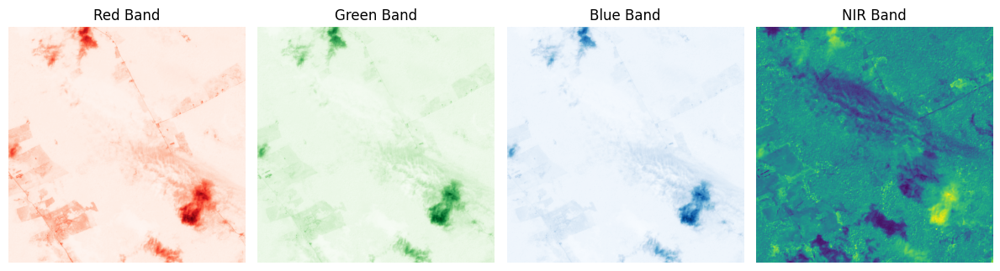

/content/drive/MyDrive/content/drive/GreenGuardians/AMAZON512/Training/images/S2A_MSIL2A_20200111T142701_N0213_R053_T20NQG_20200111T164651_01_13.tif
/content/drive/MyDrive/content/drive/GreenGuardians/AMAZON512/Training/masks/S2A_MSIL2A_20200111T142701_N0213_R053_T20NQG_20200111T164651_01_13.tif


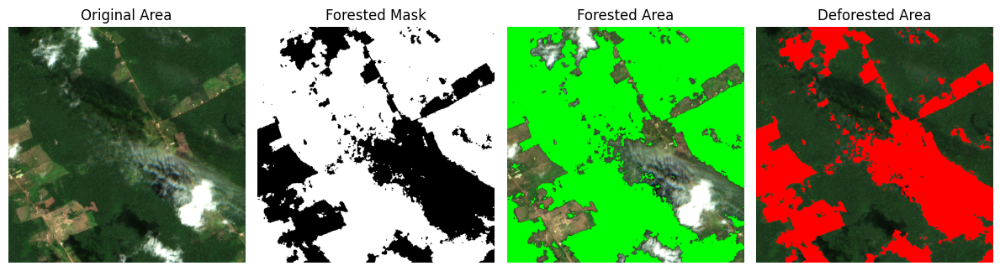

/content/drive/MyDrive/content/drive/GreenGuardians/AMAZON256/Training/images/S2A_MSIL2A_20200111T142701_N0213_R053_T20NQG_20200111T164651_01_13_tile256_0_0.tif


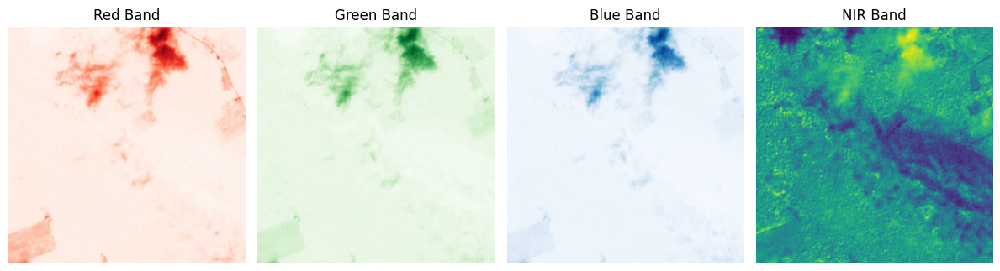

/content/drive/MyDrive/content/drive/GreenGuardians/AMAZON256/Training/images/S2A_MSIL2A_20200111T142701_N0213_R053_T20NQG_20200111T164651_01_13_tile256_0_0.tif
/content/drive/MyDrive/content/drive/GreenGuardians/AMAZON256/Training/masks/S2A_MSIL2A_20200111T142701_N0213_R053_T20NQG_20200111T164651_01_13_tile256_0_0.tif


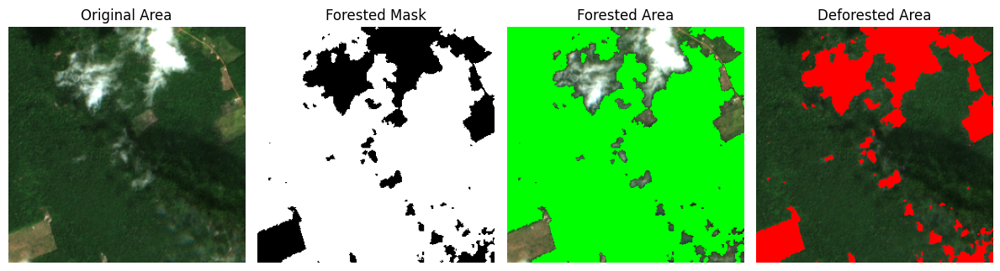

/content/drive/MyDrive/content/drive/GreenGuardians/AMAZON256/Training/images/S2A_MSIL2A_20200111T142701_N0213_R053_T20NQG_20200111T164651_01_13_tile256_0_1.tif


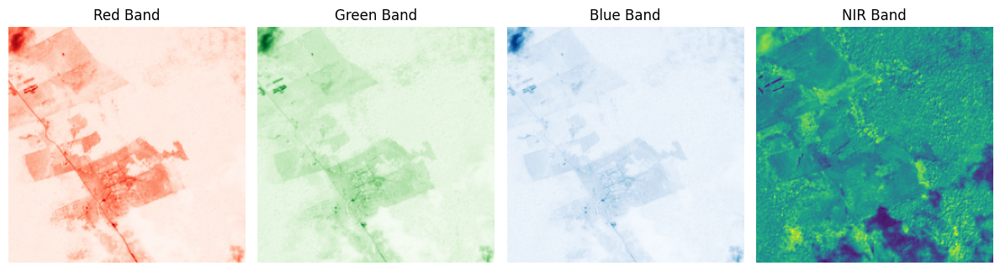

/content/drive/MyDrive/content/drive/GreenGuardians/AMAZON256/Training/images/S2A_MSIL2A_20200111T142701_N0213_R053_T20NQG_20200111T164651_01_13_tile256_0_1.tif
/content/drive/MyDrive/content/drive/GreenGuardians/AMAZON256/Training/masks/S2A_MSIL2A_20200111T142701_N0213_R053_T20NQG_20200111T164651_01_13_tile256_0_1.tif


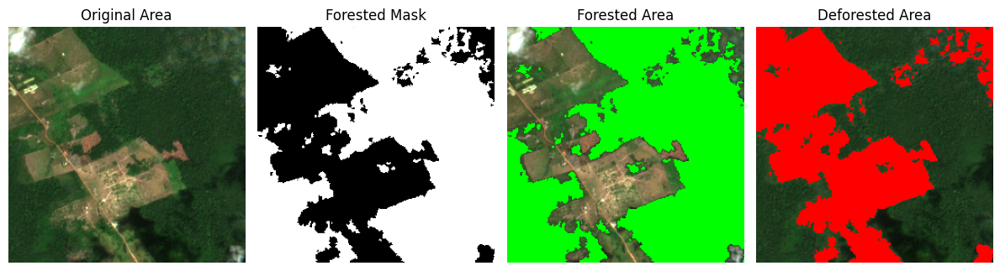

/content/drive/MyDrive/content/drive/GreenGuardians/AMAZON256/Training/images/S2A_MSIL2A_20200111T142701_N0213_R053_T20NQG_20200111T164651_01_13_tile256_1_0.tif


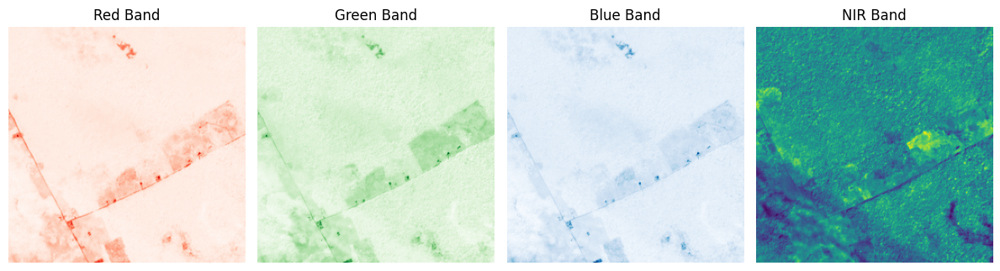

/content/drive/MyDrive/content/drive/GreenGuardians/AMAZON256/Training/images/S2A_MSIL2A_20200111T142701_N0213_R053_T20NQG_20200111T164651_01_13_tile256_1_0.tif
/content/drive/MyDrive/content/drive/GreenGuardians/AMAZON256/Training/masks/S2A_MSIL2A_20200111T142701_N0213_R053_T20NQG_20200111T164651_01_13_tile256_1_0.tif


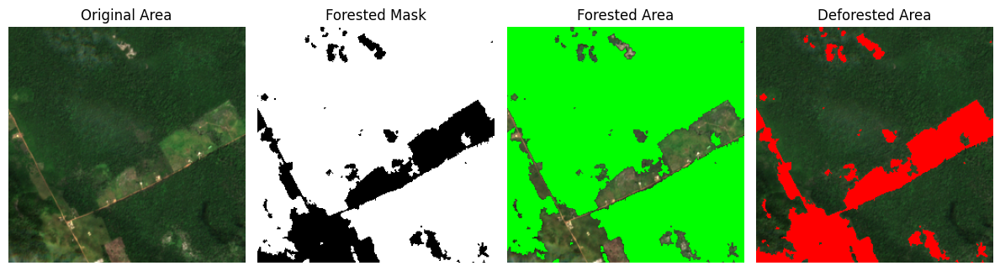

/content/drive/MyDrive/content/drive/GreenGuardians/AMAZON256/Training/images/S2A_MSIL2A_20200111T142701_N0213_R053_T20NQG_20200111T164651_01_13_tile256_1_1.tif


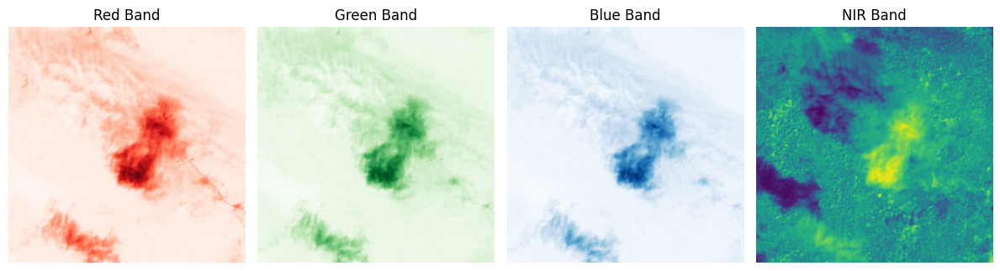

/content/drive/MyDrive/content/drive/GreenGuardians/AMAZON256/Training/images/S2A_MSIL2A_20200111T142701_N0213_R053_T20NQG_20200111T164651_01_13_tile256_1_1.tif
/content/drive/MyDrive/content/drive/GreenGuardians/AMAZON256/Training/masks/S2A_MSIL2A_20200111T142701_N0213_R053_T20NQG_20200111T164651_01_13_tile256_1_1.tif


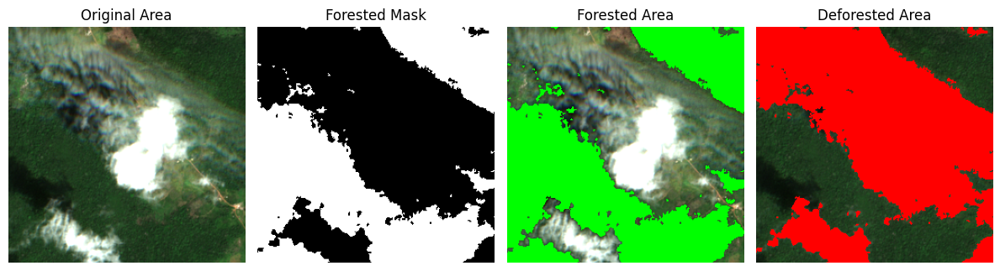

In [111]:

in_path = get_paths_to_data('amazon', 'train')
out_path = get_path_to_output('amazon', 'train')

split_images( in_path, out_path )
displayForestData( in_path, 1)
displayForestData(out_path, 4)


in path: ('/content/drive/MyDrive/content/drive/GreenGuardians/AMAZON512/Test/images/', '/content/drive/MyDrive/content/drive/GreenGuardians/AMAZON512/Test/masks/')
out path: ('/content/drive/MyDrive/content/drive/GreenGuardians/AMAZON256/Test/images/', '/content/drive/MyDrive/content/drive/GreenGuardians/AMAZON256/Test/masks/')
/content/drive/MyDrive/content/drive/GreenGuardians/AMAZON512/Test/images/S2A_MSIL2A_20200111T142701_N0213_R053_T20NQG_20200111T164651_01_06.tif


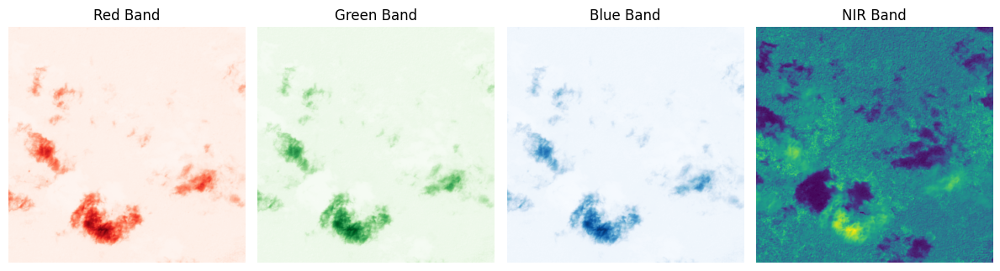

/content/drive/MyDrive/content/drive/GreenGuardians/AMAZON512/Test/images/S2A_MSIL2A_20200111T142701_N0213_R053_T20NQG_20200111T164651_01_06.tif
/content/drive/MyDrive/content/drive/GreenGuardians/AMAZON512/Test/masks/S2A_MSIL2A_20200111T142701_N0213_R053_T20NQG_20200111T164651_01_06.tif


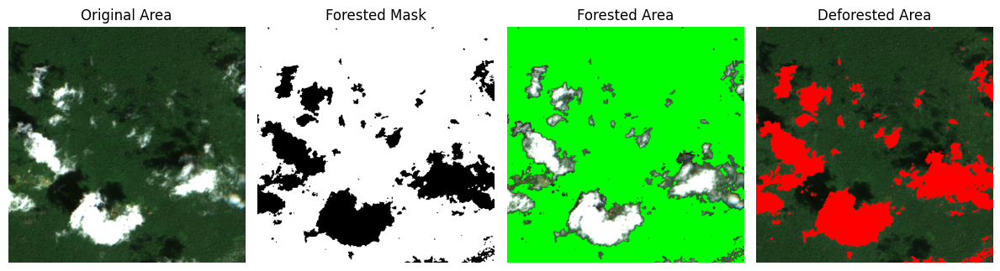

/content/drive/MyDrive/content/drive/GreenGuardians/AMAZON256/Test/images/S2A_MSIL2A_20200111T142701_N0213_R053_T20NQG_20200111T164651_01_06_tile256_0_0.tif


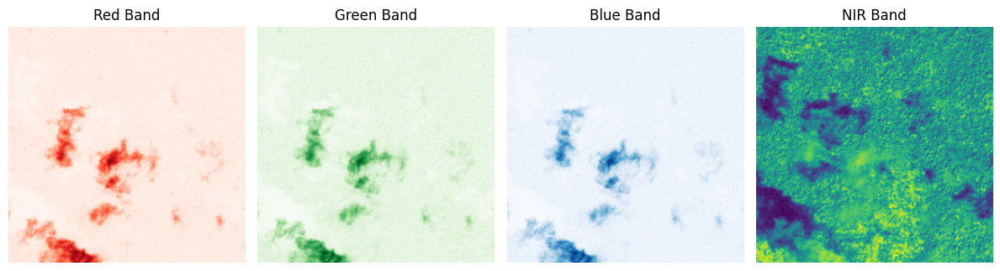

/content/drive/MyDrive/content/drive/GreenGuardians/AMAZON256/Test/images/S2A_MSIL2A_20200111T142701_N0213_R053_T20NQG_20200111T164651_01_06_tile256_0_0.tif
/content/drive/MyDrive/content/drive/GreenGuardians/AMAZON256/Test/masks/S2A_MSIL2A_20200111T142701_N0213_R053_T20NQG_20200111T164651_01_06_tile256_0_0.tif


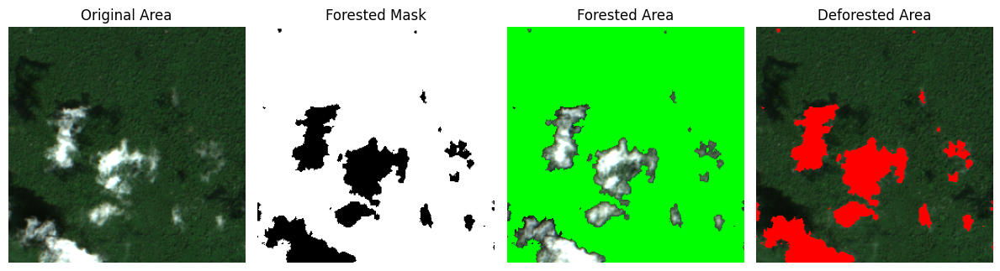

/content/drive/MyDrive/content/drive/GreenGuardians/AMAZON256/Test/images/S2A_MSIL2A_20200111T142701_N0213_R053_T20NQG_20200111T164651_01_06_tile256_0_1.tif


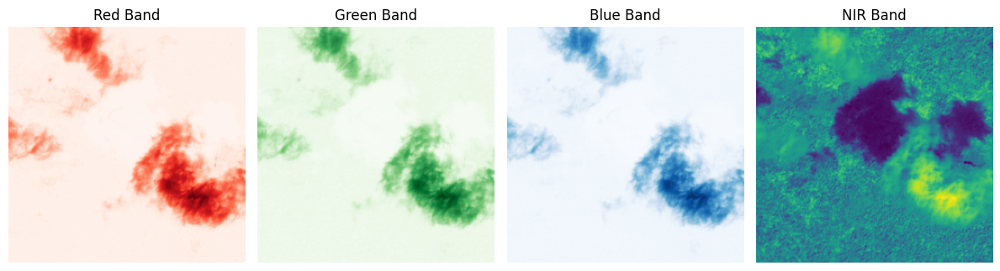

/content/drive/MyDrive/content/drive/GreenGuardians/AMAZON256/Test/images/S2A_MSIL2A_20200111T142701_N0213_R053_T20NQG_20200111T164651_01_06_tile256_0_1.tif
/content/drive/MyDrive/content/drive/GreenGuardians/AMAZON256/Test/masks/S2A_MSIL2A_20200111T142701_N0213_R053_T20NQG_20200111T164651_01_06_tile256_0_1.tif


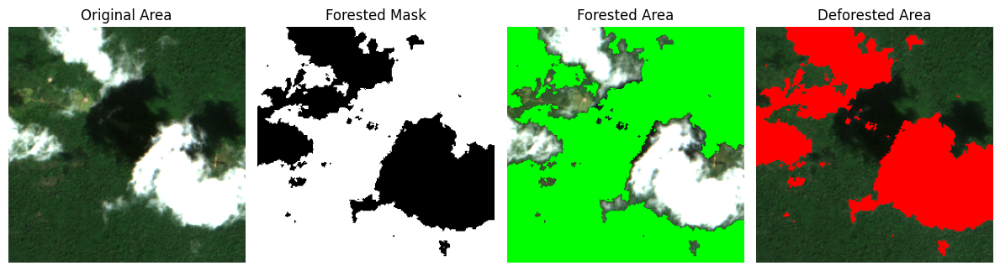

/content/drive/MyDrive/content/drive/GreenGuardians/AMAZON256/Test/images/S2A_MSIL2A_20200111T142701_N0213_R053_T20NQG_20200111T164651_01_06_tile256_1_0.tif


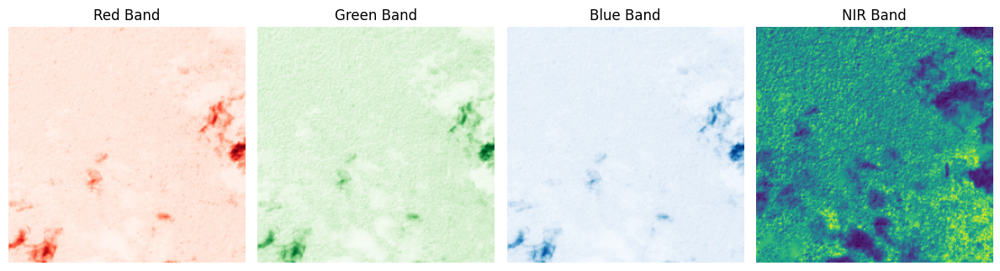

/content/drive/MyDrive/content/drive/GreenGuardians/AMAZON256/Test/images/S2A_MSIL2A_20200111T142701_N0213_R053_T20NQG_20200111T164651_01_06_tile256_1_0.tif
/content/drive/MyDrive/content/drive/GreenGuardians/AMAZON256/Test/masks/S2A_MSIL2A_20200111T142701_N0213_R053_T20NQG_20200111T164651_01_06_tile256_1_0.tif


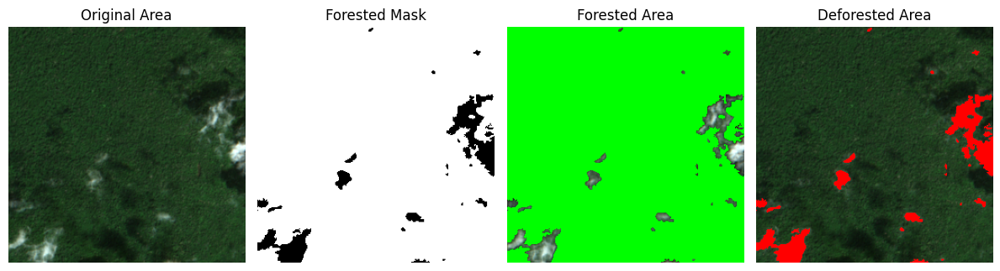

/content/drive/MyDrive/content/drive/GreenGuardians/AMAZON256/Test/images/S2A_MSIL2A_20200111T142701_N0213_R053_T20NQG_20200111T164651_01_06_tile256_1_1.tif


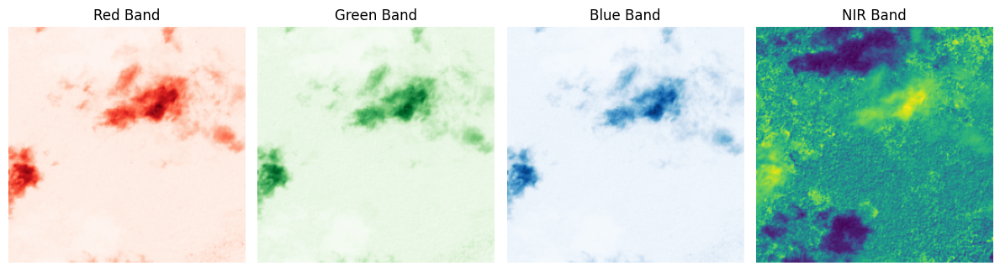

/content/drive/MyDrive/content/drive/GreenGuardians/AMAZON256/Test/images/S2A_MSIL2A_20200111T142701_N0213_R053_T20NQG_20200111T164651_01_06_tile256_1_1.tif
/content/drive/MyDrive/content/drive/GreenGuardians/AMAZON256/Test/masks/S2A_MSIL2A_20200111T142701_N0213_R053_T20NQG_20200111T164651_01_06_tile256_1_1.tif


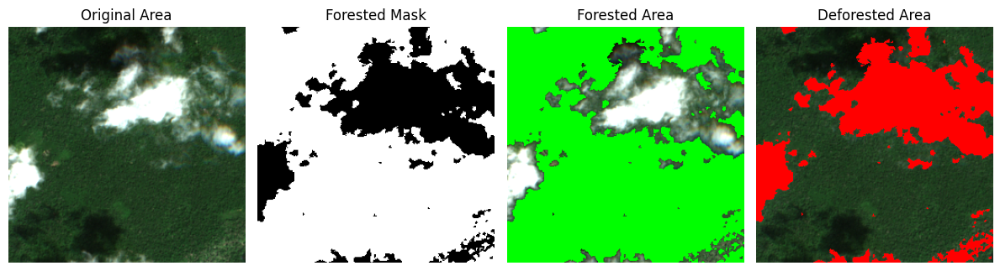

In [113]:

in_path = get_paths_to_data('amazon', 'test')
out_path = get_path_to_output('amazon', 'test')

print( "in path:", in_path)
print( "out path:", out_path)

split_images( in_path, out_path )
displayForestData( in_path, 1)
displayForestData(out_path, 4)

/content/drive/MyDrive/content/drive/GreenGuardians/AMAZON512/Validation/images/S2A_MSIL2A_20200111T142701_N0213_R053_T20NQG_20200111T164651_01_04.tif


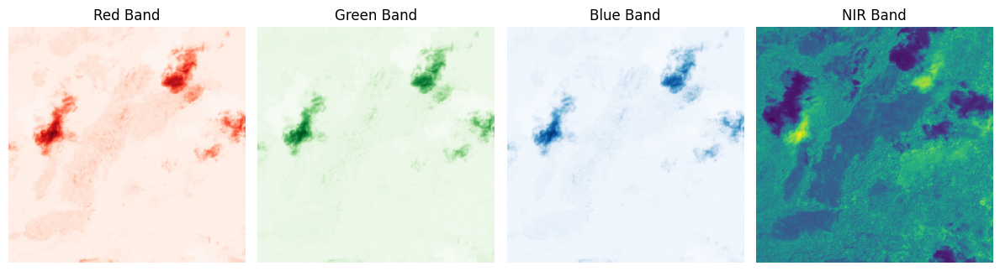

/content/drive/MyDrive/content/drive/GreenGuardians/AMAZON512/Validation/images/S2A_MSIL2A_20200111T142701_N0213_R053_T20NQG_20200111T164651_01_04.tif
/content/drive/MyDrive/content/drive/GreenGuardians/AMAZON512/Validation/masks/S2A_MSIL2A_20200111T142701_N0213_R053_T20NQG_20200111T164651_01_04.tif


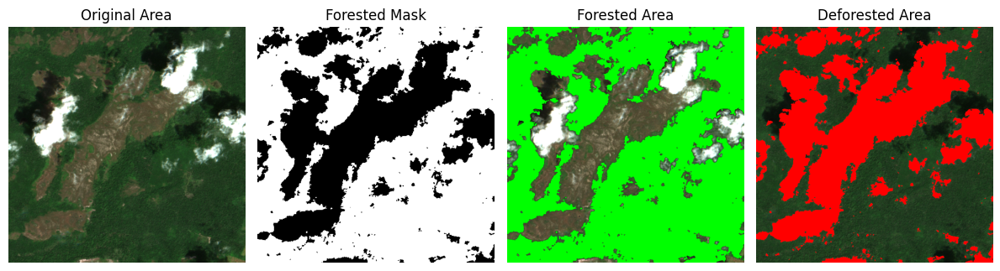

/content/drive/MyDrive/content/drive/GreenGuardians/AMAZON256/Validation/images/S2A_MSIL2A_20200111T142701_N0213_R053_T20NQG_20200111T164651_01_04_tile256_0_0.tif


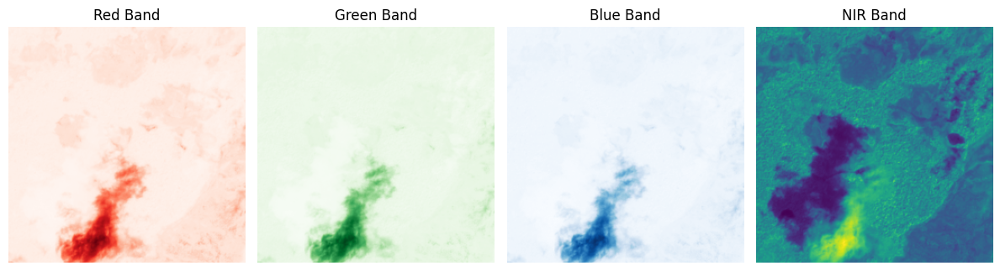

/content/drive/MyDrive/content/drive/GreenGuardians/AMAZON256/Validation/images/S2A_MSIL2A_20200111T142701_N0213_R053_T20NQG_20200111T164651_01_04_tile256_0_0.tif
/content/drive/MyDrive/content/drive/GreenGuardians/AMAZON256/Validation/masks/S2A_MSIL2A_20200111T142701_N0213_R053_T20NQG_20200111T164651_01_04_tile256_0_0.tif


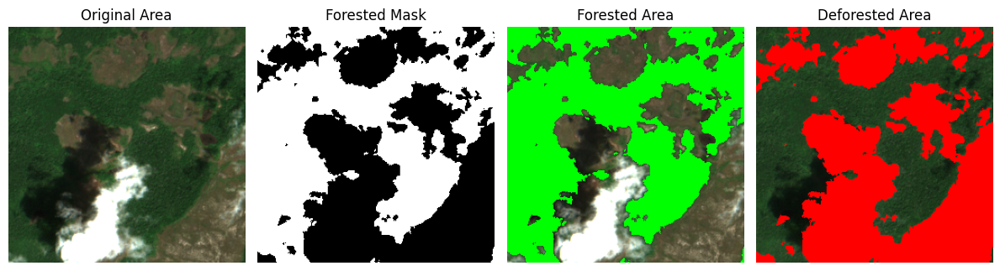

/content/drive/MyDrive/content/drive/GreenGuardians/AMAZON256/Validation/images/S2A_MSIL2A_20200111T142701_N0213_R053_T20NQG_20200111T164651_01_04_tile256_0_1.tif


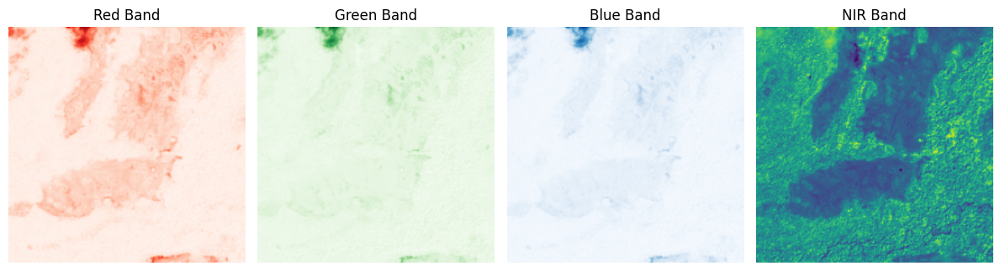

/content/drive/MyDrive/content/drive/GreenGuardians/AMAZON256/Validation/images/S2A_MSIL2A_20200111T142701_N0213_R053_T20NQG_20200111T164651_01_04_tile256_0_1.tif
/content/drive/MyDrive/content/drive/GreenGuardians/AMAZON256/Validation/masks/S2A_MSIL2A_20200111T142701_N0213_R053_T20NQG_20200111T164651_01_04_tile256_0_1.tif


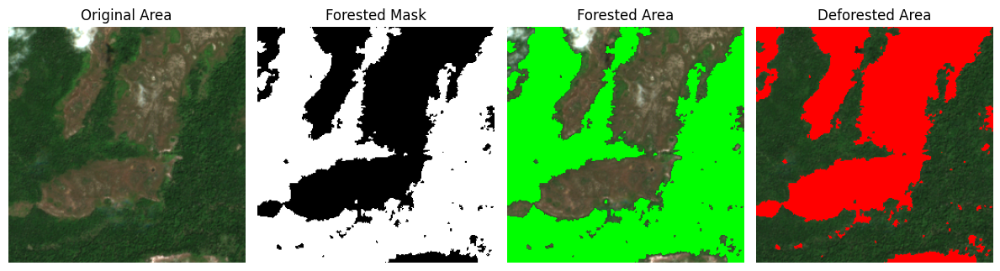

/content/drive/MyDrive/content/drive/GreenGuardians/AMAZON256/Validation/images/S2A_MSIL2A_20200111T142701_N0213_R053_T20NQG_20200111T164651_01_04_tile256_1_0.tif


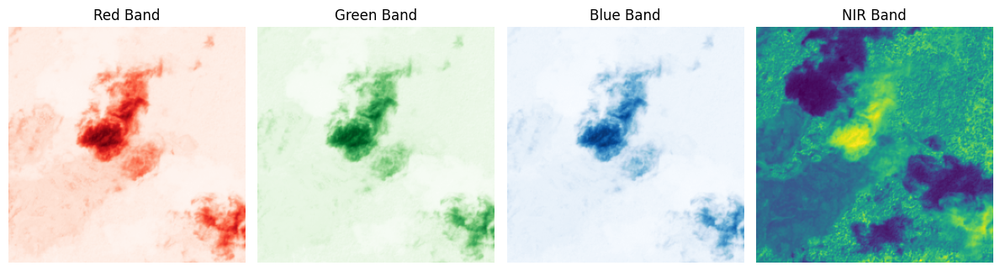

/content/drive/MyDrive/content/drive/GreenGuardians/AMAZON256/Validation/images/S2A_MSIL2A_20200111T142701_N0213_R053_T20NQG_20200111T164651_01_04_tile256_1_0.tif
/content/drive/MyDrive/content/drive/GreenGuardians/AMAZON256/Validation/masks/S2A_MSIL2A_20200111T142701_N0213_R053_T20NQG_20200111T164651_01_04_tile256_1_0.tif


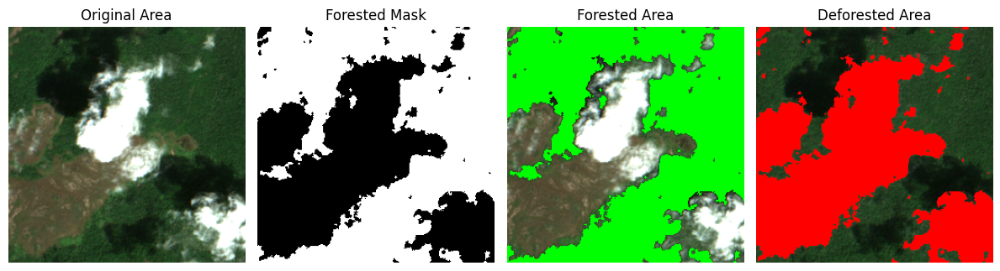

/content/drive/MyDrive/content/drive/GreenGuardians/AMAZON256/Validation/images/S2A_MSIL2A_20200111T142701_N0213_R053_T20NQG_20200111T164651_01_04_tile256_1_1.tif


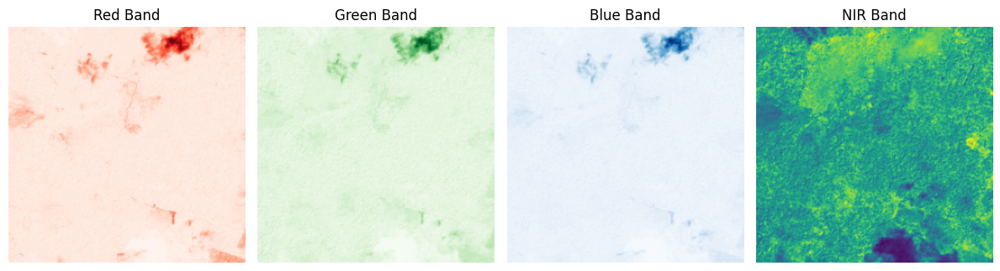

/content/drive/MyDrive/content/drive/GreenGuardians/AMAZON256/Validation/images/S2A_MSIL2A_20200111T142701_N0213_R053_T20NQG_20200111T164651_01_04_tile256_1_1.tif
/content/drive/MyDrive/content/drive/GreenGuardians/AMAZON256/Validation/masks/S2A_MSIL2A_20200111T142701_N0213_R053_T20NQG_20200111T164651_01_04_tile256_1_1.tif


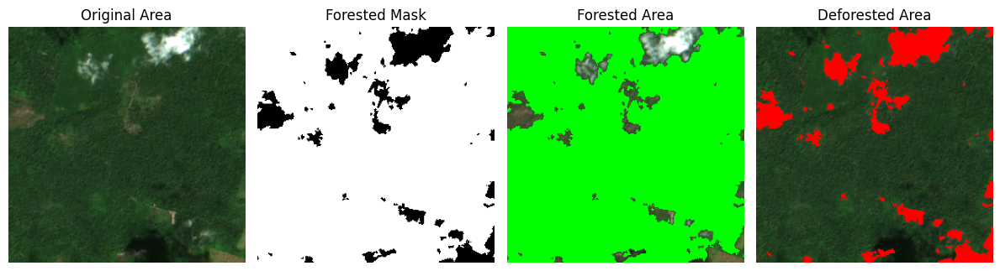

In [114]:

in_path = get_paths_to_data('amazon', 'val')
out_path = get_path_to_output('amazon', 'val')

split_images( in_path, out_path )
displayForestData( in_path, 1)
displayForestData(out_path, 4)

/content/drive/MyDrive/content/drive/GreenGuardians/ATLANTIC512/Training/images/S2A_MSIL2A_20190715T125311_N0213_R052_T24LVH_20190715T150206_01_04.tif


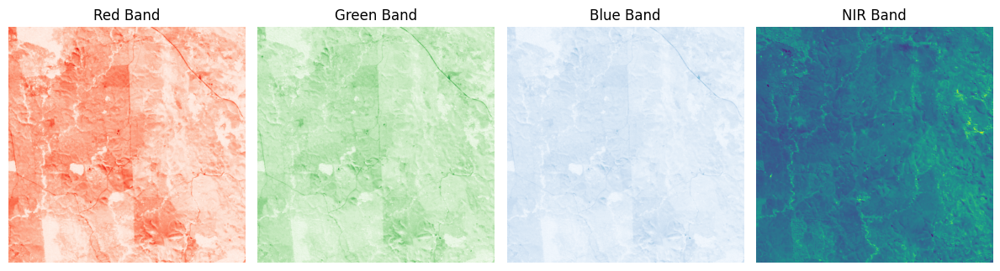

/content/drive/MyDrive/content/drive/GreenGuardians/ATLANTIC512/Training/images/S2A_MSIL2A_20190715T125311_N0213_R052_T24LVH_20190715T150206_01_04.tif
/content/drive/MyDrive/content/drive/GreenGuardians/ATLANTIC512/Training/masks/S2A_MSIL2A_20190715T125311_N0213_R052_T24LVH_20190715T150206_01_04.tif


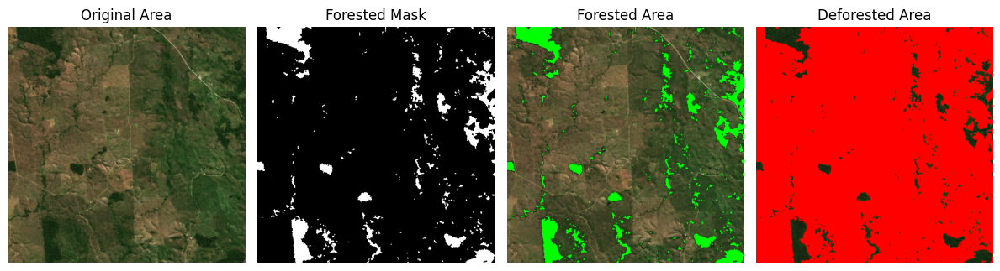

/content/drive/MyDrive/content/drive/GreenGuardians/ATLANTIC256/Training/images/S2A_MSIL2A_20190715T125311_N0213_R052_T24LVH_20190715T150206_01_04_tile256_0_0.tif


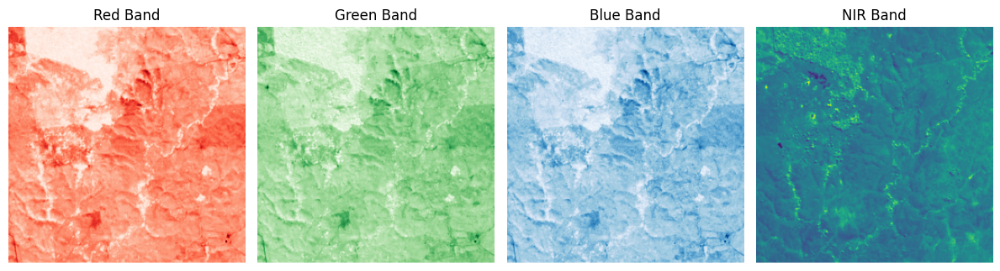

/content/drive/MyDrive/content/drive/GreenGuardians/ATLANTIC256/Training/images/S2A_MSIL2A_20190715T125311_N0213_R052_T24LVH_20190715T150206_01_04_tile256_0_0.tif
/content/drive/MyDrive/content/drive/GreenGuardians/ATLANTIC256/Training/masks/S2A_MSIL2A_20190715T125311_N0213_R052_T24LVH_20190715T150206_01_04_tile256_0_0.tif


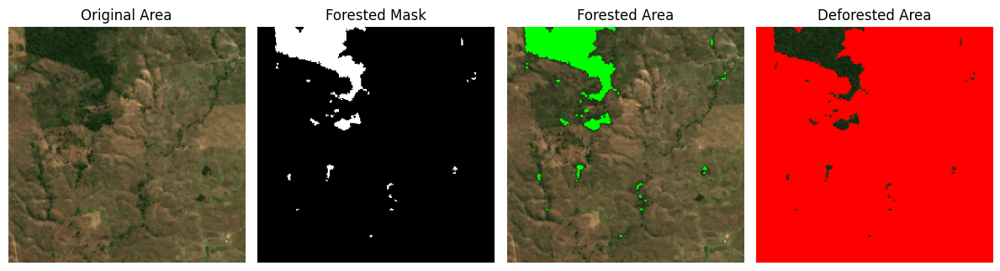

/content/drive/MyDrive/content/drive/GreenGuardians/ATLANTIC256/Training/images/S2A_MSIL2A_20190715T125311_N0213_R052_T24LVH_20190715T150206_01_04_tile256_0_1.tif


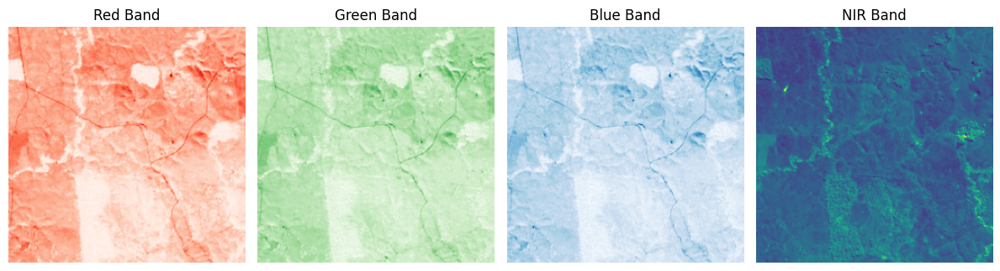

/content/drive/MyDrive/content/drive/GreenGuardians/ATLANTIC256/Training/images/S2A_MSIL2A_20190715T125311_N0213_R052_T24LVH_20190715T150206_01_04_tile256_0_1.tif
/content/drive/MyDrive/content/drive/GreenGuardians/ATLANTIC256/Training/masks/S2A_MSIL2A_20190715T125311_N0213_R052_T24LVH_20190715T150206_01_04_tile256_0_1.tif


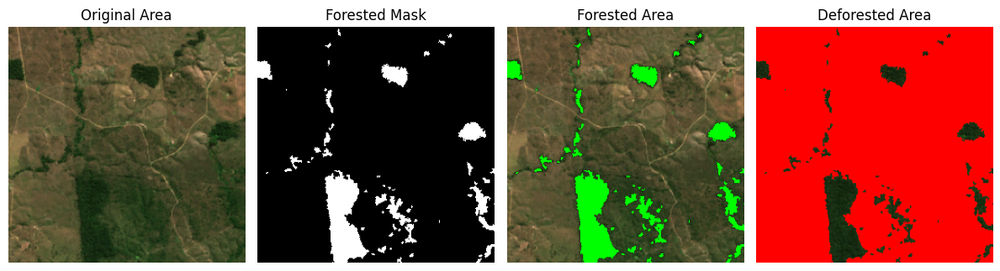

/content/drive/MyDrive/content/drive/GreenGuardians/ATLANTIC256/Training/images/S2A_MSIL2A_20190715T125311_N0213_R052_T24LVH_20190715T150206_01_04_tile256_1_0.tif


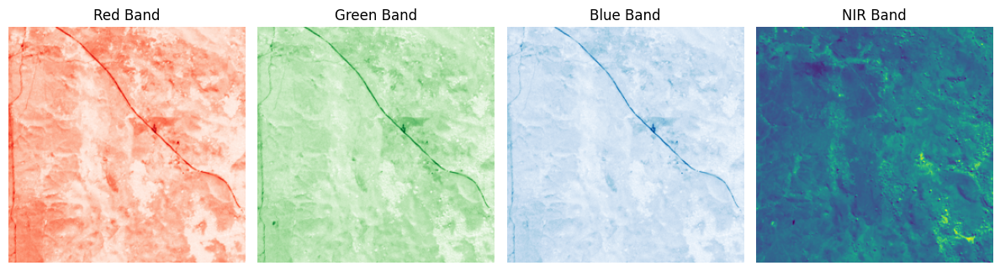

/content/drive/MyDrive/content/drive/GreenGuardians/ATLANTIC256/Training/images/S2A_MSIL2A_20190715T125311_N0213_R052_T24LVH_20190715T150206_01_04_tile256_1_0.tif
/content/drive/MyDrive/content/drive/GreenGuardians/ATLANTIC256/Training/masks/S2A_MSIL2A_20190715T125311_N0213_R052_T24LVH_20190715T150206_01_04_tile256_1_0.tif


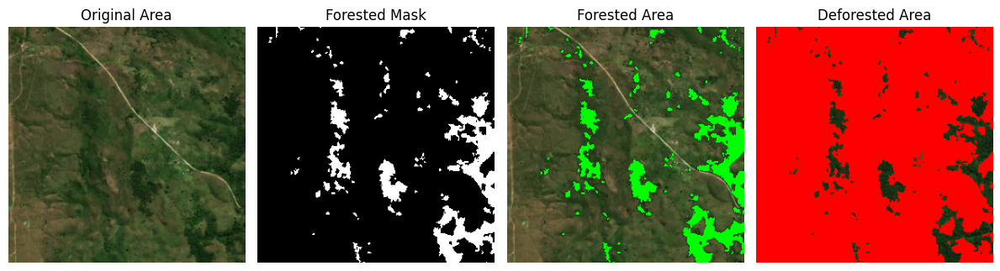

/content/drive/MyDrive/content/drive/GreenGuardians/ATLANTIC256/Training/images/S2A_MSIL2A_20190715T125311_N0213_R052_T24LVH_20190715T150206_01_04_tile256_1_1.tif


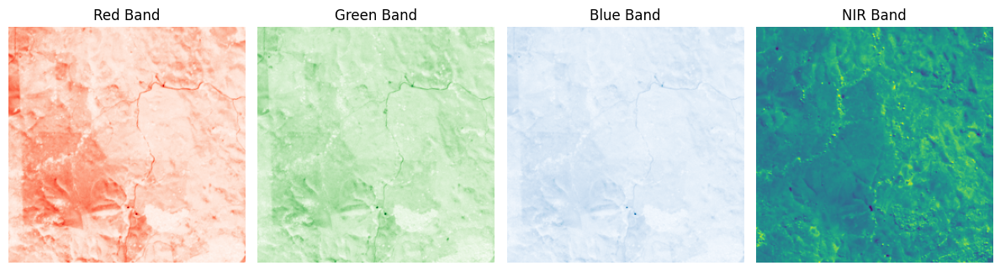

/content/drive/MyDrive/content/drive/GreenGuardians/ATLANTIC256/Training/images/S2A_MSIL2A_20190715T125311_N0213_R052_T24LVH_20190715T150206_01_04_tile256_1_1.tif
/content/drive/MyDrive/content/drive/GreenGuardians/ATLANTIC256/Training/masks/S2A_MSIL2A_20190715T125311_N0213_R052_T24LVH_20190715T150206_01_04_tile256_1_1.tif


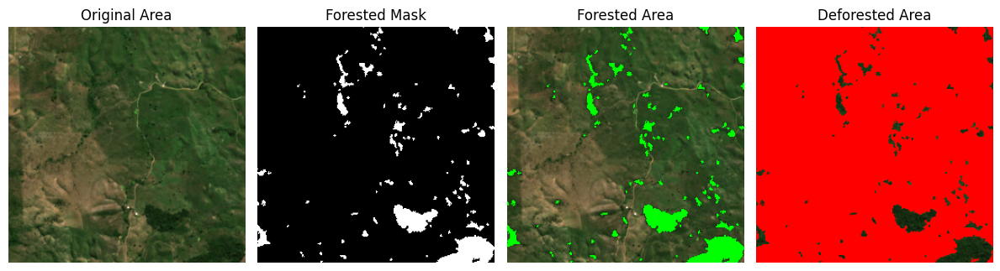

In [115]:
in_path = get_paths_to_data('atlantic', 'train')
out_path = get_path_to_output('atlantic', 'train')

split_images( in_path, out_path )
displayForestData( in_path, 1)
displayForestData(out_path, 4)

/content/drive/MyDrive/content/drive/GreenGuardians/ATLANTIC512/Test/images/S2A_MSIL2A_20190715T125311_N0213_R052_T24LVH_20190715T150206_08_08.tif


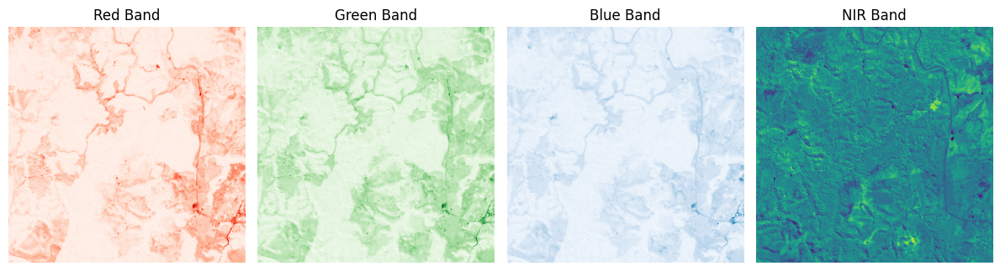

/content/drive/MyDrive/content/drive/GreenGuardians/ATLANTIC512/Test/images/S2A_MSIL2A_20190715T125311_N0213_R052_T24LVH_20190715T150206_08_08.tif
/content/drive/MyDrive/content/drive/GreenGuardians/ATLANTIC512/Test/masks/S2A_MSIL2A_20190715T125311_N0213_R052_T24LVH_20190715T150206_08_08.tif


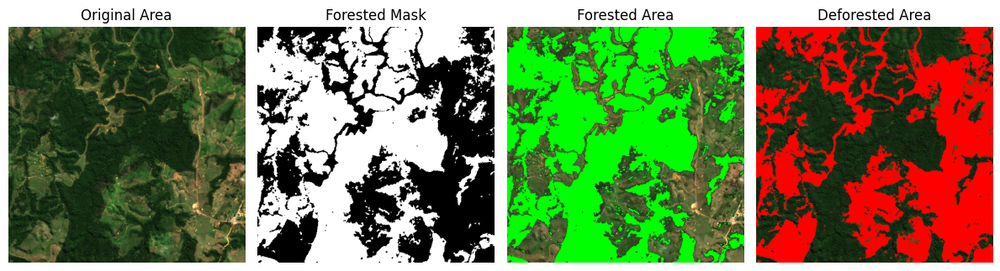

/content/drive/MyDrive/content/drive/GreenGuardians/ATLANTIC256/Test/images/S2A_MSIL2A_20190715T125311_N0213_R052_T24LVH_20190715T150206_08_08_tile256_0_0.tif


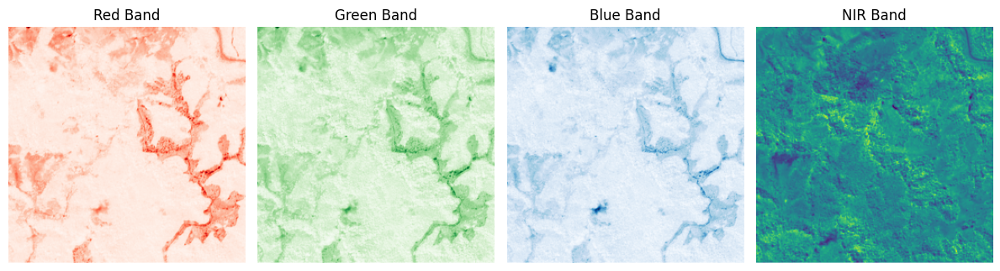

/content/drive/MyDrive/content/drive/GreenGuardians/ATLANTIC256/Test/images/S2A_MSIL2A_20190715T125311_N0213_R052_T24LVH_20190715T150206_08_08_tile256_0_0.tif
/content/drive/MyDrive/content/drive/GreenGuardians/ATLANTIC256/Test/masks/S2A_MSIL2A_20190715T125311_N0213_R052_T24LVH_20190715T150206_08_08_tile256_0_0.tif


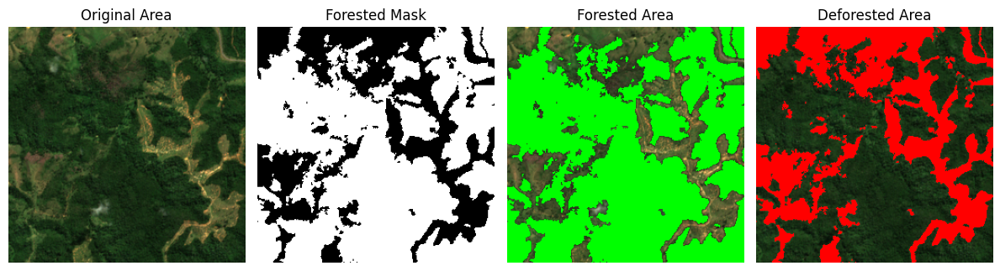

/content/drive/MyDrive/content/drive/GreenGuardians/ATLANTIC256/Test/images/S2A_MSIL2A_20190715T125311_N0213_R052_T24LVH_20190715T150206_08_08_tile256_0_1.tif


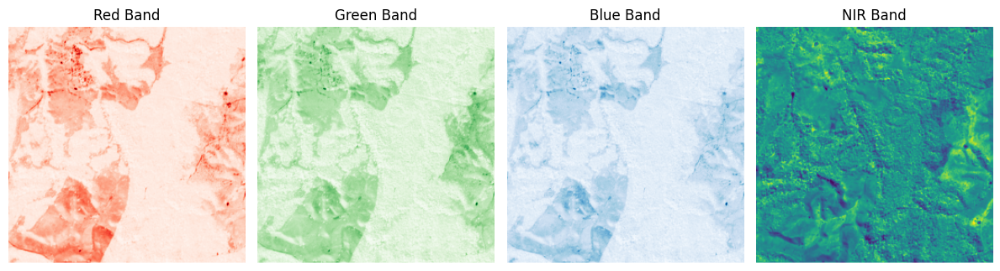

/content/drive/MyDrive/content/drive/GreenGuardians/ATLANTIC256/Test/images/S2A_MSIL2A_20190715T125311_N0213_R052_T24LVH_20190715T150206_08_08_tile256_0_1.tif
/content/drive/MyDrive/content/drive/GreenGuardians/ATLANTIC256/Test/masks/S2A_MSIL2A_20190715T125311_N0213_R052_T24LVH_20190715T150206_08_08_tile256_0_1.tif


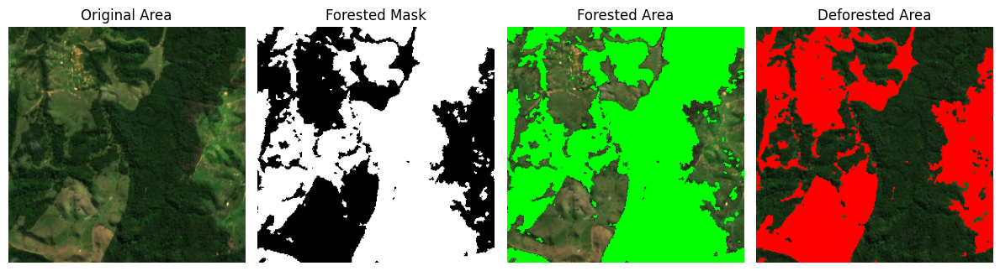

/content/drive/MyDrive/content/drive/GreenGuardians/ATLANTIC256/Test/images/S2A_MSIL2A_20190715T125311_N0213_R052_T24LVH_20190715T150206_08_08_tile256_1_0.tif


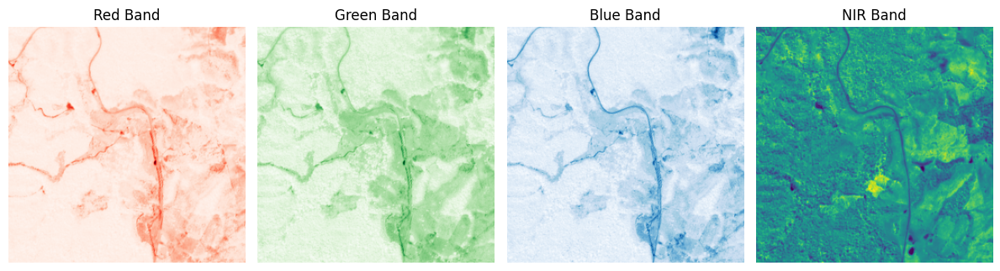

/content/drive/MyDrive/content/drive/GreenGuardians/ATLANTIC256/Test/images/S2A_MSIL2A_20190715T125311_N0213_R052_T24LVH_20190715T150206_08_08_tile256_1_0.tif
/content/drive/MyDrive/content/drive/GreenGuardians/ATLANTIC256/Test/masks/S2A_MSIL2A_20190715T125311_N0213_R052_T24LVH_20190715T150206_08_08_tile256_1_0.tif


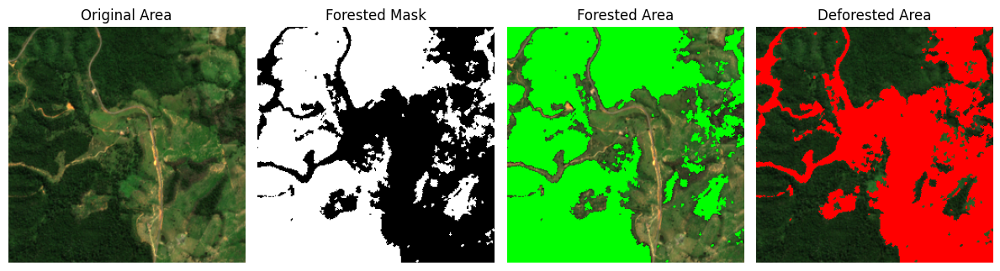

/content/drive/MyDrive/content/drive/GreenGuardians/ATLANTIC256/Test/images/S2A_MSIL2A_20190715T125311_N0213_R052_T24LVH_20190715T150206_08_08_tile256_1_1.tif


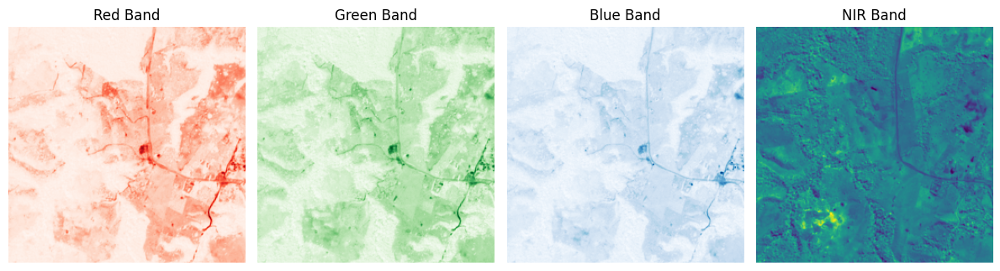

/content/drive/MyDrive/content/drive/GreenGuardians/ATLANTIC256/Test/images/S2A_MSIL2A_20190715T125311_N0213_R052_T24LVH_20190715T150206_08_08_tile256_1_1.tif
/content/drive/MyDrive/content/drive/GreenGuardians/ATLANTIC256/Test/masks/S2A_MSIL2A_20190715T125311_N0213_R052_T24LVH_20190715T150206_08_08_tile256_1_1.tif


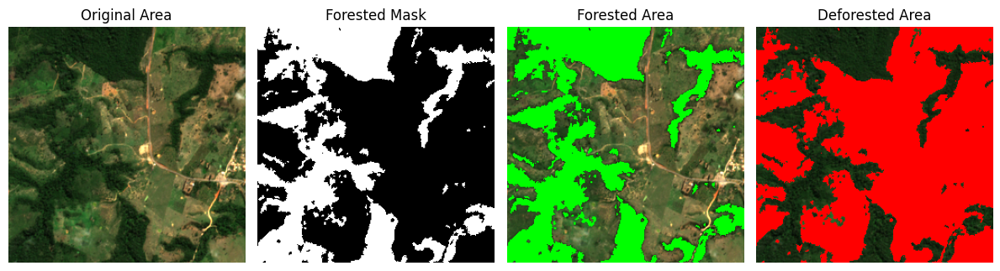

In [116]:
in_path = get_paths_to_data('atlantic', 'test')
out_path = get_path_to_output('atlantic', 'test')

split_images( in_path, out_path )
displayForestData( in_path, 1)
displayForestData(out_path, 4)

/content/drive/MyDrive/content/drive/GreenGuardians/ATLANTIC512/Validation/images/S2A_MSIL2A_20190715T125311_N0213_R052_T24LVH_20190715T150206_01_01.tif


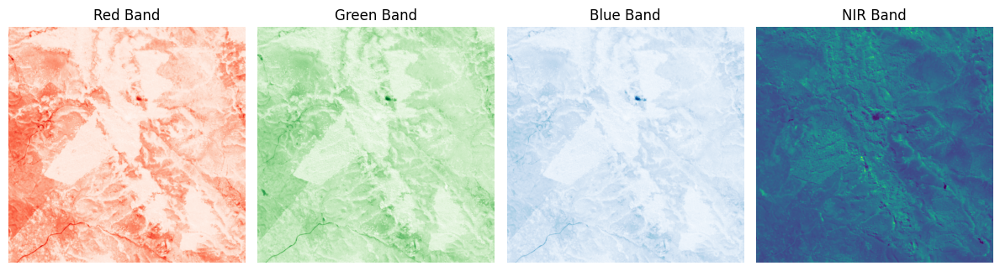

/content/drive/MyDrive/content/drive/GreenGuardians/ATLANTIC512/Validation/images/S2A_MSIL2A_20190715T125311_N0213_R052_T24LVH_20190715T150206_01_01.tif
/content/drive/MyDrive/content/drive/GreenGuardians/ATLANTIC512/Validation/masks/S2A_MSIL2A_20190715T125311_N0213_R052_T24LVH_20190715T150206_01_01.tif


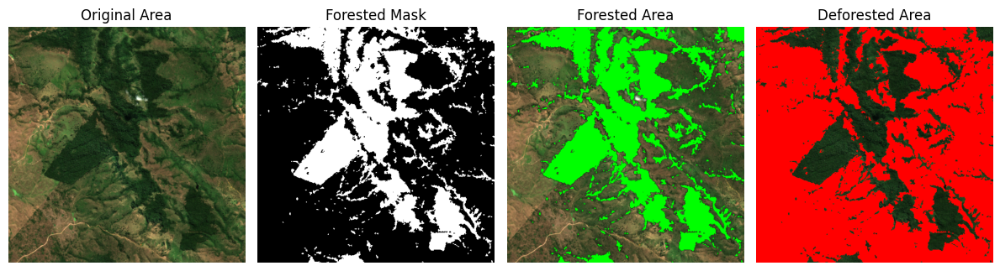

/content/drive/MyDrive/content/drive/GreenGuardians/ATLANTIC256/Validation/images/S2A_MSIL2A_20190715T125311_N0213_R052_T24LVH_20190715T150206_01_01_tile256_0_0.tif


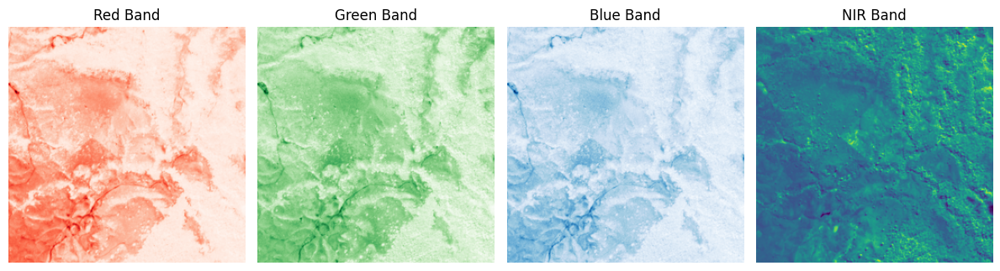

/content/drive/MyDrive/content/drive/GreenGuardians/ATLANTIC256/Validation/images/S2A_MSIL2A_20190715T125311_N0213_R052_T24LVH_20190715T150206_01_01_tile256_0_0.tif
/content/drive/MyDrive/content/drive/GreenGuardians/ATLANTIC256/Validation/masks/S2A_MSIL2A_20190715T125311_N0213_R052_T24LVH_20190715T150206_01_01_tile256_0_0.tif


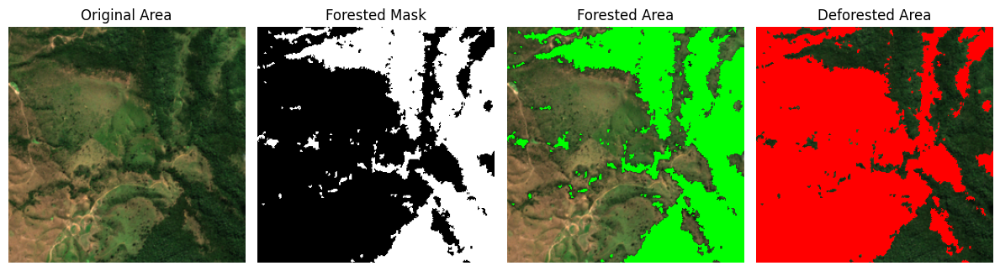

/content/drive/MyDrive/content/drive/GreenGuardians/ATLANTIC256/Validation/images/S2A_MSIL2A_20190715T125311_N0213_R052_T24LVH_20190715T150206_01_01_tile256_0_1.tif


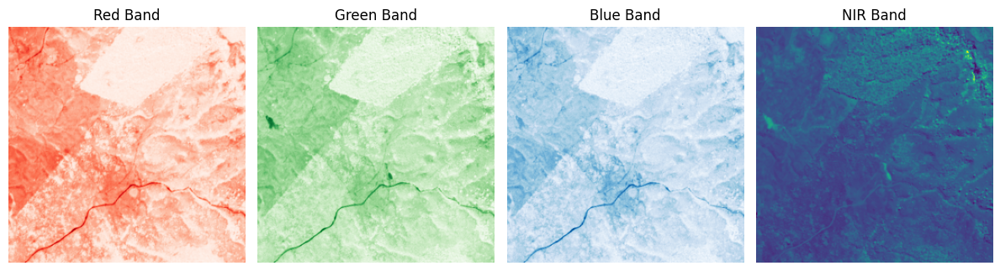

/content/drive/MyDrive/content/drive/GreenGuardians/ATLANTIC256/Validation/images/S2A_MSIL2A_20190715T125311_N0213_R052_T24LVH_20190715T150206_01_01_tile256_0_1.tif
/content/drive/MyDrive/content/drive/GreenGuardians/ATLANTIC256/Validation/masks/S2A_MSIL2A_20190715T125311_N0213_R052_T24LVH_20190715T150206_01_01_tile256_0_1.tif


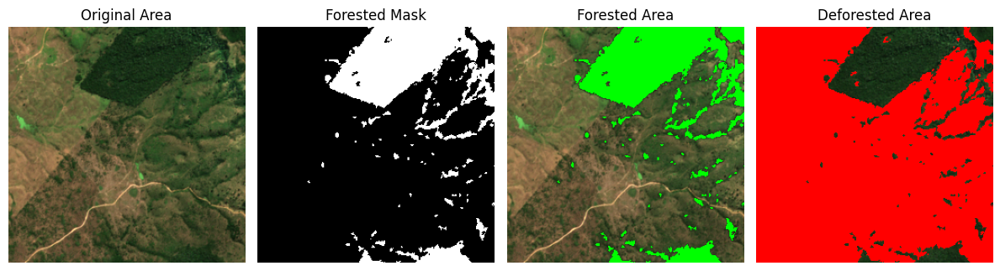

/content/drive/MyDrive/content/drive/GreenGuardians/ATLANTIC256/Validation/images/S2A_MSIL2A_20190715T125311_N0213_R052_T24LVH_20190715T150206_01_01_tile256_1_0.tif


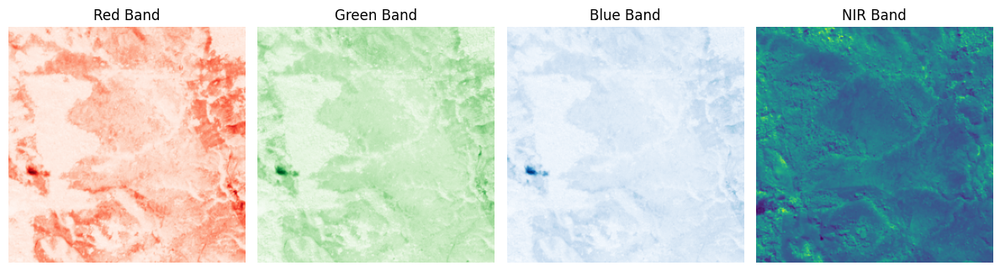

/content/drive/MyDrive/content/drive/GreenGuardians/ATLANTIC256/Validation/images/S2A_MSIL2A_20190715T125311_N0213_R052_T24LVH_20190715T150206_01_01_tile256_1_0.tif
/content/drive/MyDrive/content/drive/GreenGuardians/ATLANTIC256/Validation/masks/S2A_MSIL2A_20190715T125311_N0213_R052_T24LVH_20190715T150206_01_01_tile256_1_0.tif


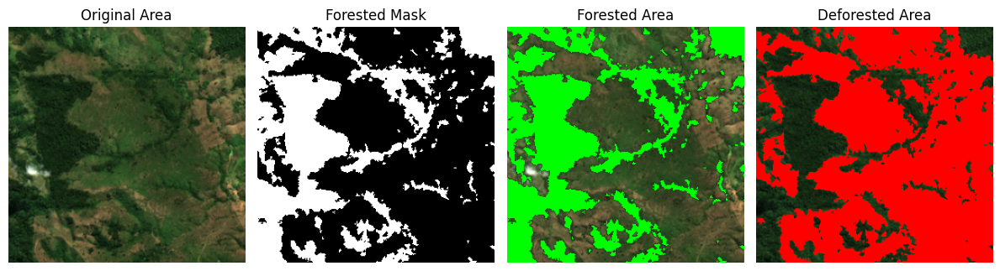

/content/drive/MyDrive/content/drive/GreenGuardians/ATLANTIC256/Validation/images/S2A_MSIL2A_20190715T125311_N0213_R052_T24LVH_20190715T150206_01_01_tile256_1_1.tif


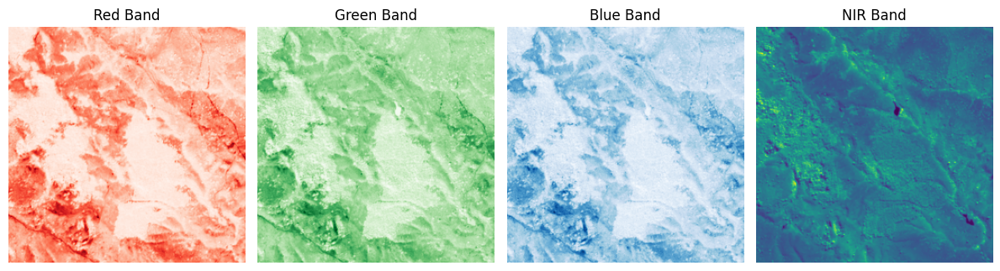

/content/drive/MyDrive/content/drive/GreenGuardians/ATLANTIC256/Validation/images/S2A_MSIL2A_20190715T125311_N0213_R052_T24LVH_20190715T150206_01_01_tile256_1_1.tif
/content/drive/MyDrive/content/drive/GreenGuardians/ATLANTIC256/Validation/masks/S2A_MSIL2A_20190715T125311_N0213_R052_T24LVH_20190715T150206_01_01_tile256_1_1.tif


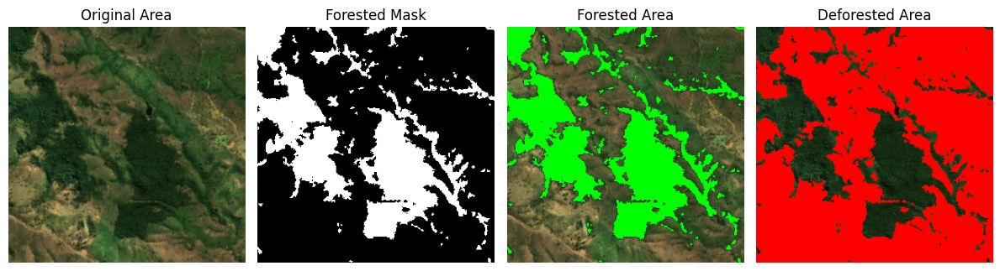

In [117]:
in_path = get_paths_to_data('atlantic', 'val')
out_path = get_path_to_output('atlantic', 'val')

split_images( in_path, out_path )
displayForestData( in_path, 1)
displayForestData(out_path, 4)